C:\Users\Ahmad\AppData\Local\Temp\ipykernel_25844\993875324.py:38: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


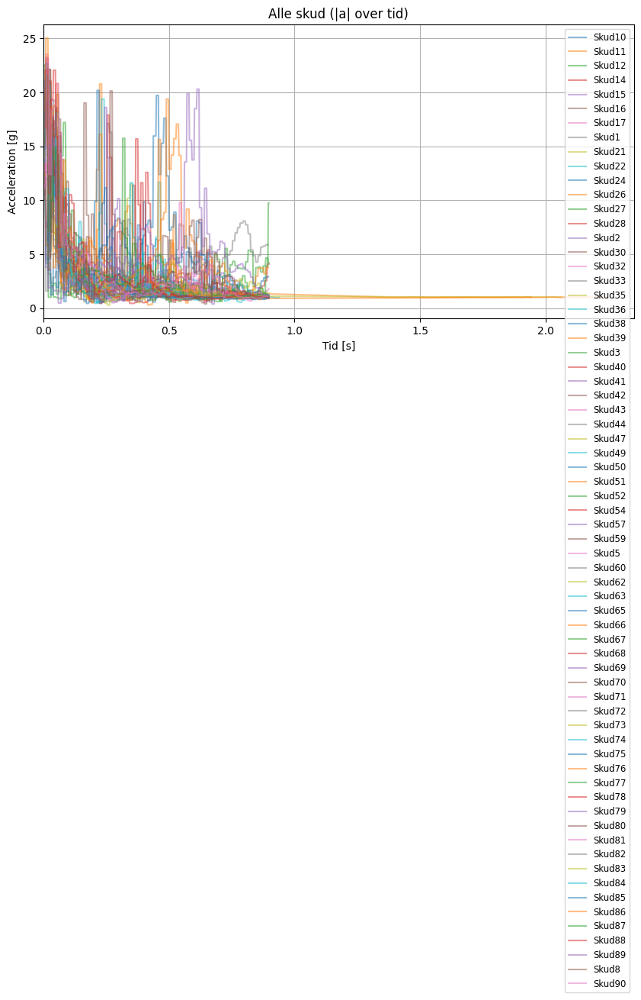

In [1]:
%matplotlib inline
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import glob, os

# Sti til dine klippede filer
path = r"c:\TML_Particle_EH5\Project\Project\DataValidation\Clipped_shots"
files = sorted(glob.glob(os.path.join(path, "skud*_clipped.csv")))

plt.figure(figsize=(10, 5))

for f in files:
    data = pd.read_csv(f)

    # Rens kolonnenavne
    data.columns = [c.strip().lower() for c in data.columns]

    # Sørg for at værdier er numeriske
    data['time'] = pd.to_numeric(data['time'], errors='coerce')
    data['a_total'] = pd.to_numeric(data['a_total'], errors='coerce')

    # Fjern evt. NaN
    data.dropna(subset=['time', 'a_total'], inplace=True)

    # Tid er allerede i sekunder (fra klippet data)
    t = data['time'].values
    a_mag = data['a_total'].values

    plt.plot(t, a_mag, alpha=0.5, label=os.path.basename(f).replace("_clipped.csv", ""))

plt.title("Alle skud (|a| over tid)")
plt.xlabel("Tid [s]")
plt.ylabel("Acceleration [g]")
plt.xlim(left=0)
plt.grid(True)
plt.legend(fontsize='small', loc='upper right')
plt.tight_layout()
plt.show()


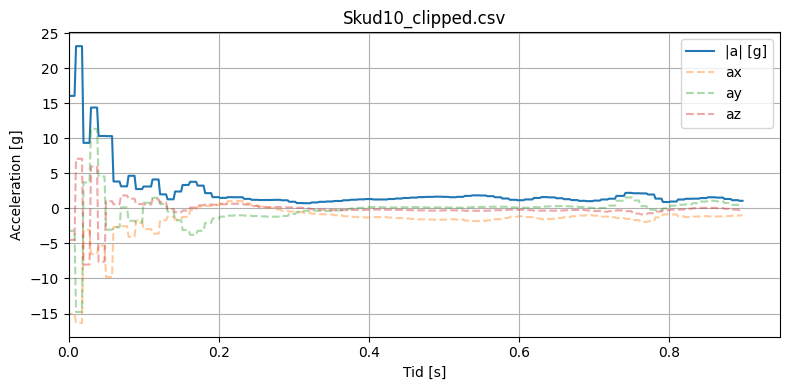

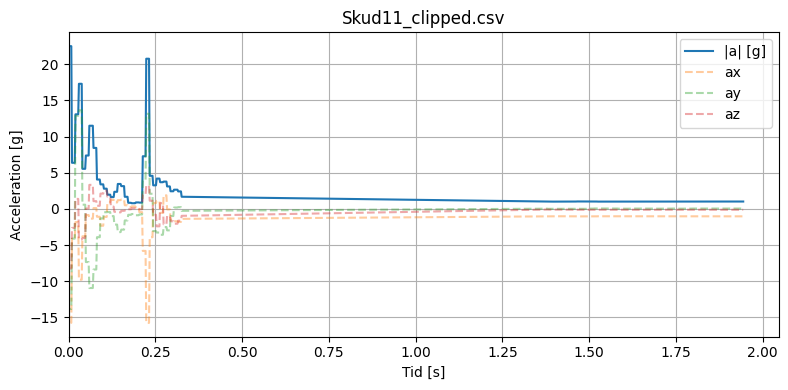

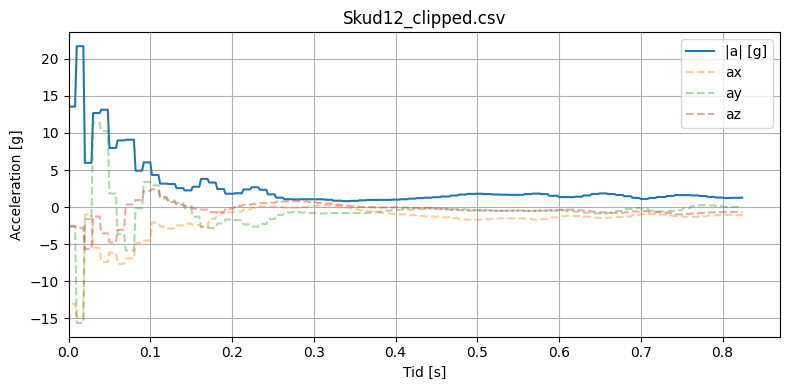

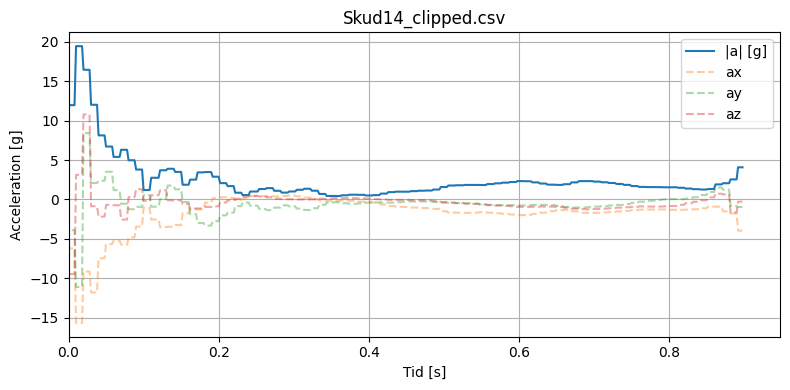

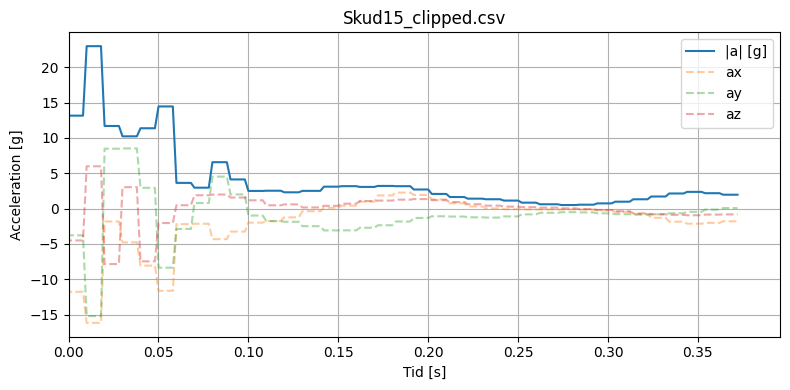

...

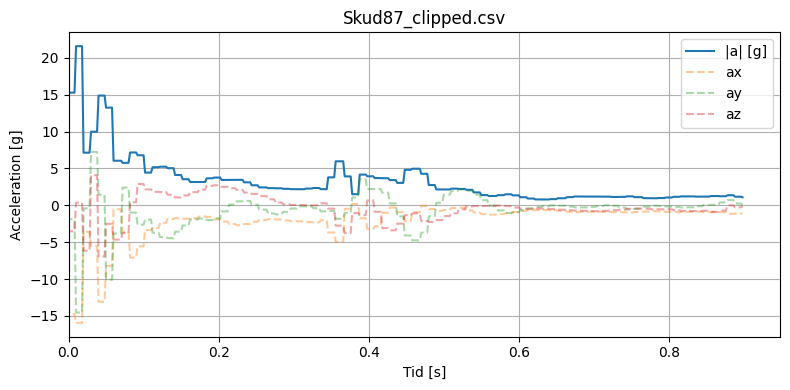

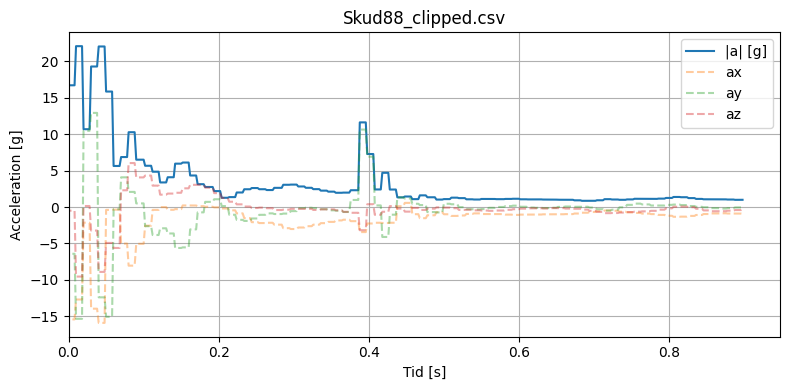

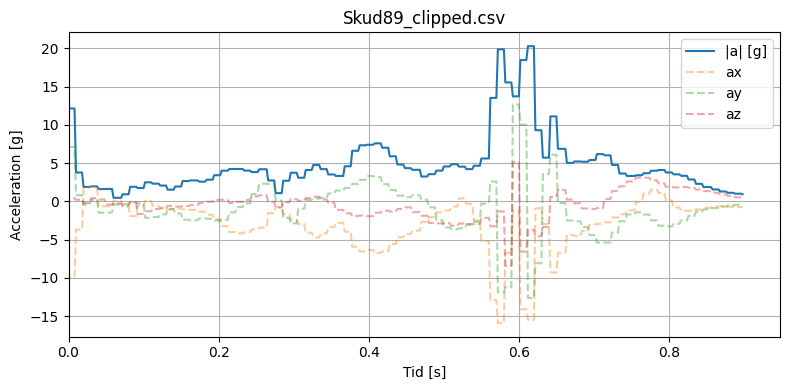

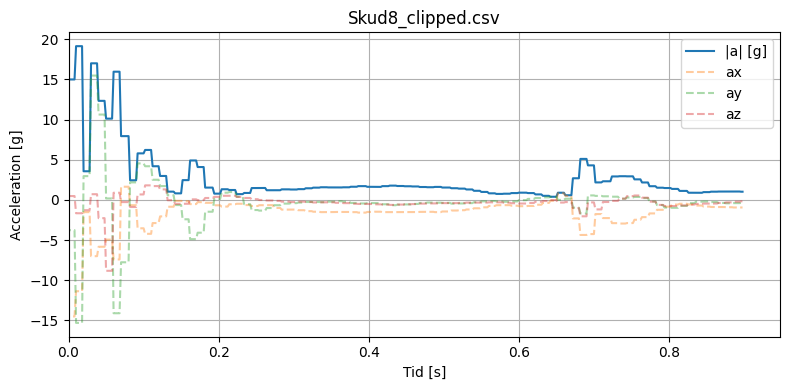

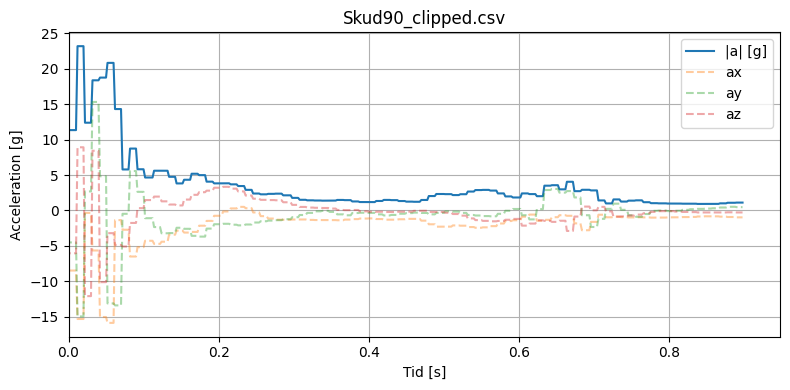

In [2]:
%matplotlib inline
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import glob, os

# Sti til dine klippede filer
path = r"c:\TML_Particle_EH5\Project\Project\DataValidation\Clipped_shots"
files = sorted(glob.glob(os.path.join(path, "skud*_clipped.csv")))

for f in files:
    data = pd.read_csv(f)
    data.columns = [c.strip().lower() for c in data.columns]

    # Konverter til numeriske værdier
    for col in ['ax', 'ay', 'az', 'time', 'a_total']:
        data[col] = pd.to_numeric(data[col], errors='coerce')
    data.dropna(subset=['time', 'a_total'], inplace=True)

    # Tid er allerede i sekunder
    t = data['time'].values
    a_mag = data['a_total'].values

    # Plot
    plt.figure(figsize=(8, 4))
    plt.plot(t, a_mag, label='|a| [g]')
    plt.plot(t, data['ax'], '--', alpha=0.4, label='ax')
    plt.plot(t, data['ay'], '--', alpha=0.4, label='ay')
    plt.plot(t, data['az'], '--', alpha=0.4, label='az')
    plt.title(os.path.basename(f))
    plt.xlabel("Tid [s]")
    plt.ylabel("Acceleration [g]")
    plt.legend()
    plt.grid(True)
    plt.xlim(left=0)
    plt.tight_layout()
    plt.show()


In [17]:
import pandas as pd
import numpy as np

data = pd.read_csv("../skud/skud1.csv", decimal=",")
data.columns = [c.strip().lower() for c in data.columns]
for col in ['accx','accy','accz','timestamp']:
    data[col] = pd.to_numeric(data[col], errors='coerce')

# beregn tidsdifferenser
dt = np.diff(data['timestamp'])
print("Antal samples:", len(data))
print("Middel sampling-interval (ms):", np.mean(dt))
print("Min / Max dt (ms):", np.min(dt), "/", np.max(dt))
print("Total varighed (s):", (data['timestamp'].iloc[-1] - data['timestamp'].iloc[0]) / 1000)


FileNotFoundError: [Errno 2] No such file or directory: '../skud/skud1.csv'

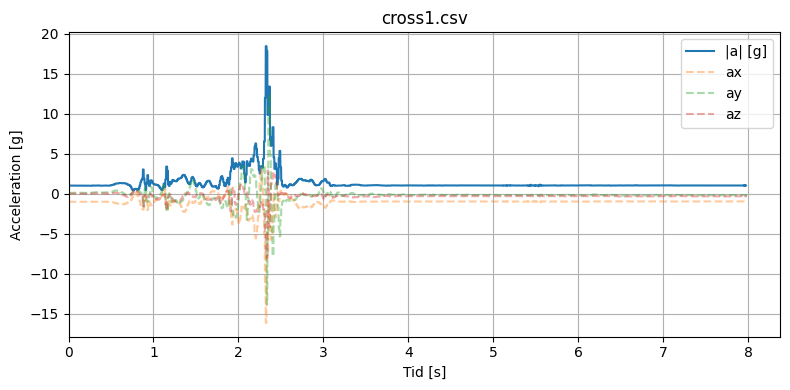

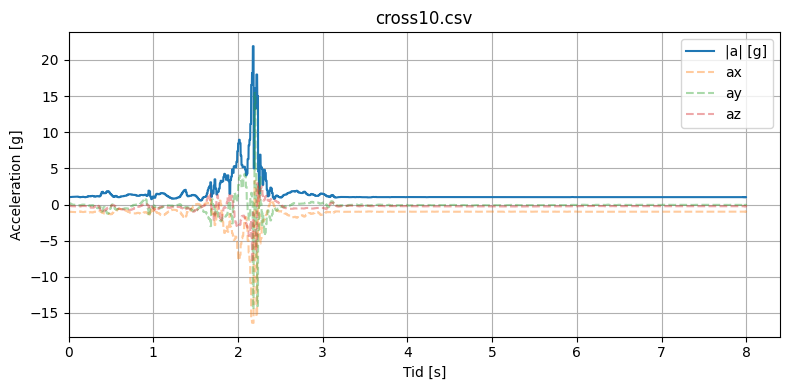

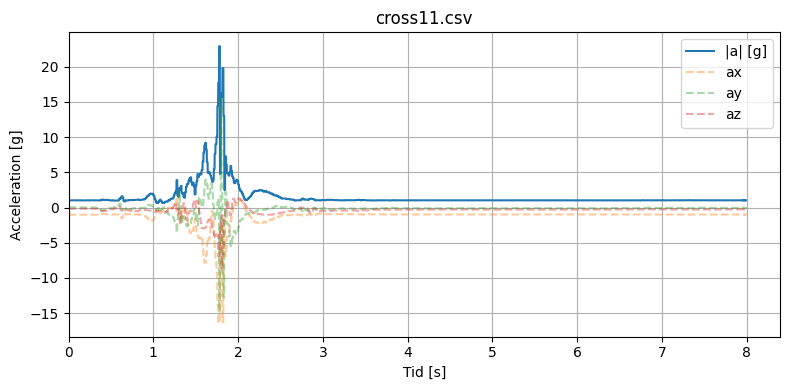

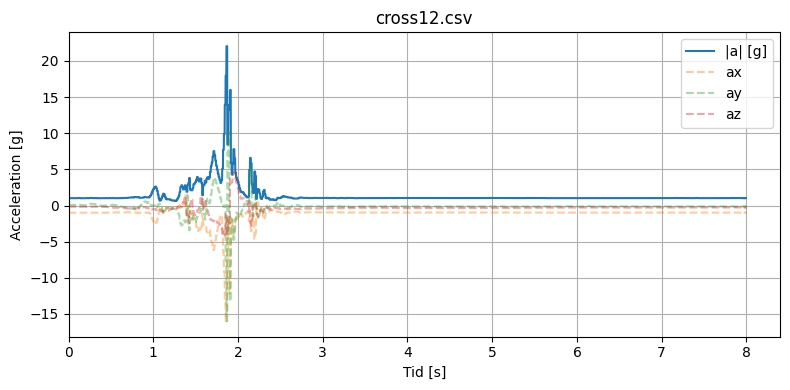

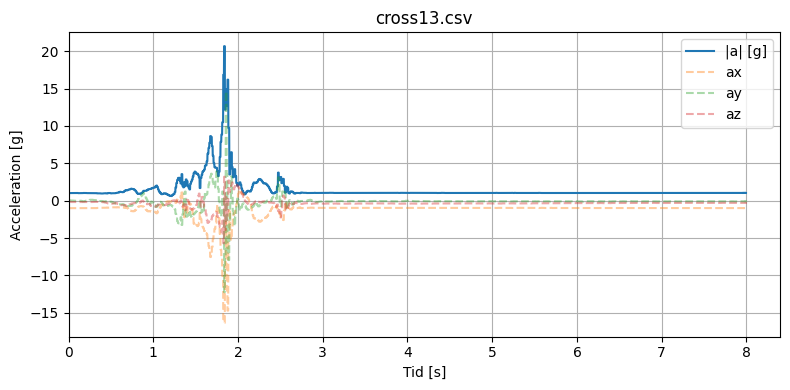

...

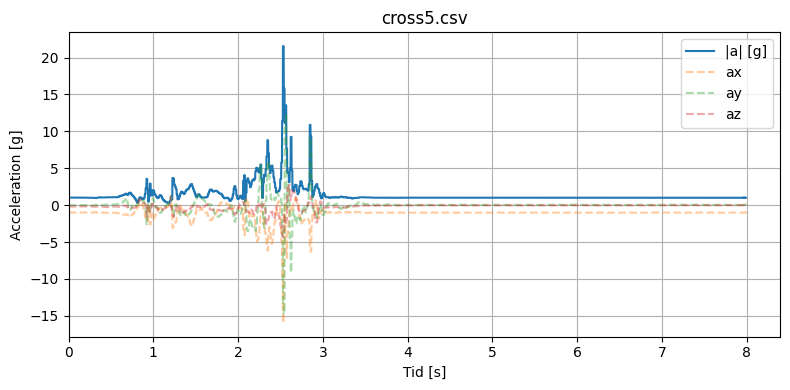

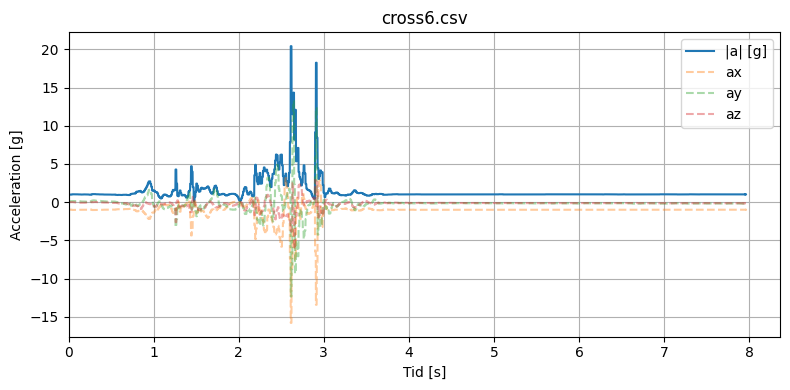

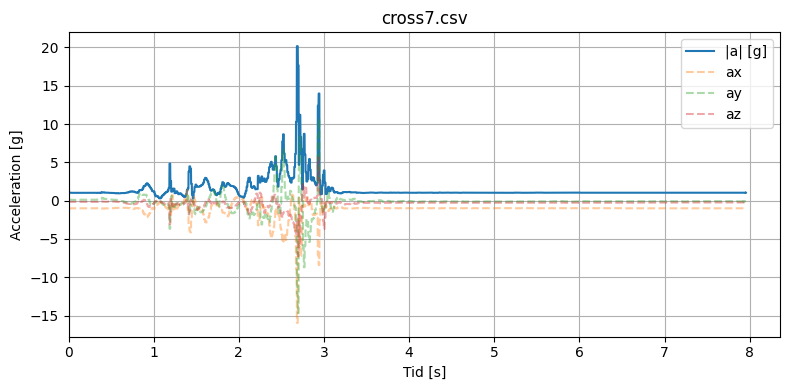

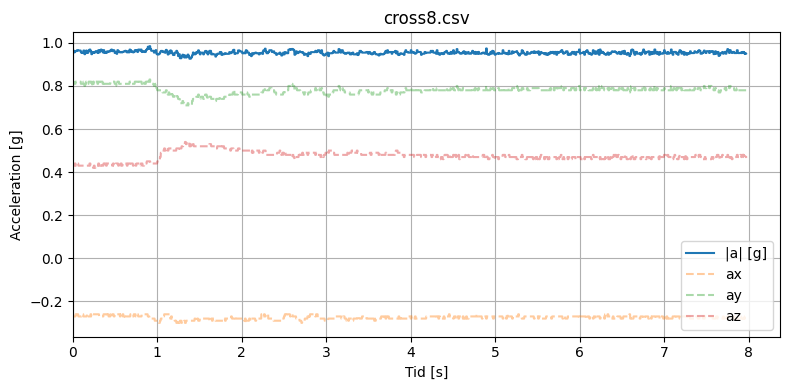

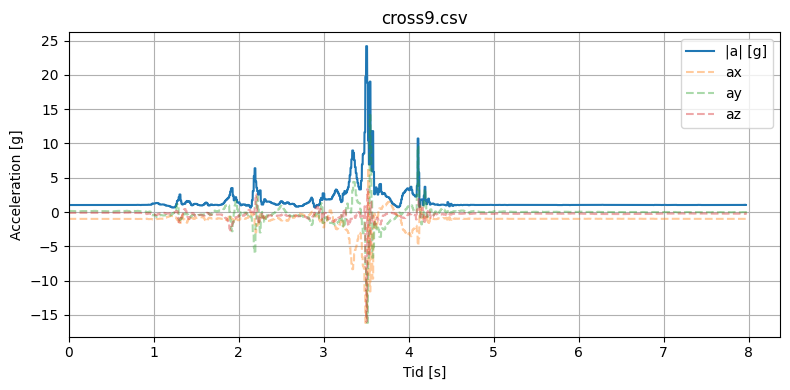

In [2]:
%matplotlib inline
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import glob, os

# Sti til dine Crosses-målinger
path = r"c:\TML_Particle_EH5\Project\Project\DataValidation\Crosses"
files = sorted(glob.glob(os.path.join(path, "cross*.csv")))

for f in files:
    # Læs CSV med komma som separator
    data = pd.read_csv(f, sep=',', encoding='utf-8-sig')

    # Fjern mellemrum og skjulte tegn fra kolonnenavne
    data.columns = [c.strip().replace('\ufeff', '').lower() for c in data.columns]

    # Konverter kolonner til numeriske værdier
    for col in ['accx', 'accy', 'accz', 'timestamp']:
        data[col] = pd.to_numeric(data[col], errors='coerce')

    # Fjern rækker med manglende data
    data.dropna(subset=['accx', 'accy', 'accz', 'timestamp'], inplace=True)

    # Beregn samlet acceleration (norm)
    data['a_mag'] = np.sqrt(data['accx']**2 + data['accy']**2 + data['accz']**2)

    # Tid i sekunder (fra mikrosekunder)
    t = (data['timestamp'] - data['timestamp'].iloc[0]) * 1e-6

    # Plot
    plt.figure(figsize=(8, 4))
    plt.plot(t, data['a_mag'], label='|a| [g]')
    plt.plot(t, data['accx'], '--', alpha=0.4, label='ax')
    plt.plot(t, data['accy'], '--', alpha=0.4, label='ay')
    plt.plot(t, data['accz'], '--', alpha=0.4, label='az')
    plt.title(os.path.basename(f))
    plt.xlabel("Tid [s]")
    plt.ylabel("Acceleration [g]")
    plt.legend()
    plt.grid(True)
    plt.xlim(left=0)
    plt.tight_layout()
    plt.show()

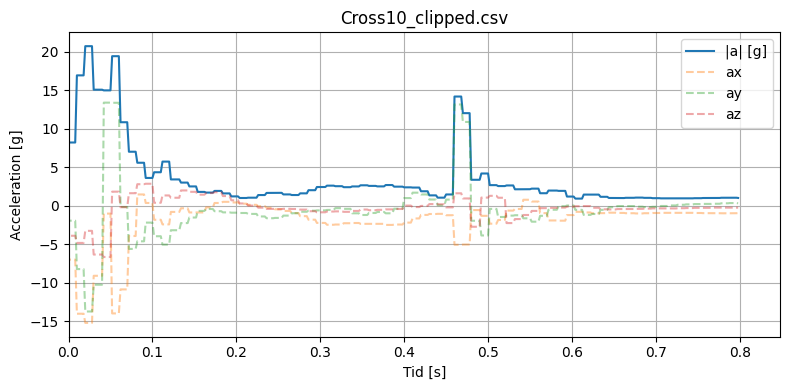

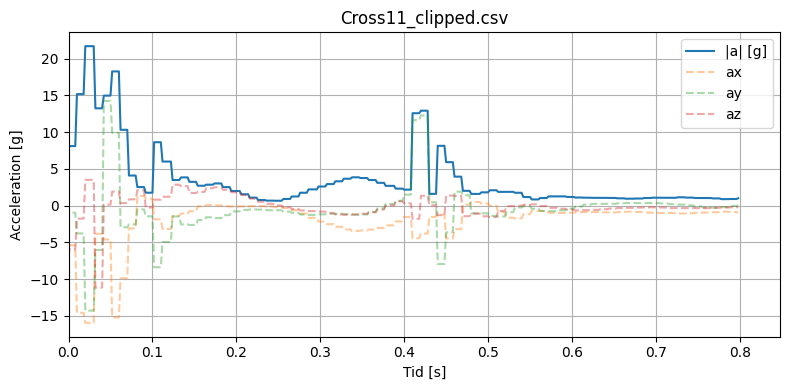

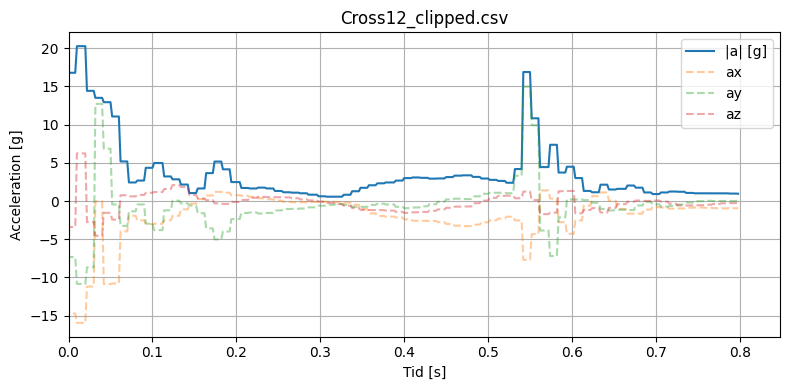

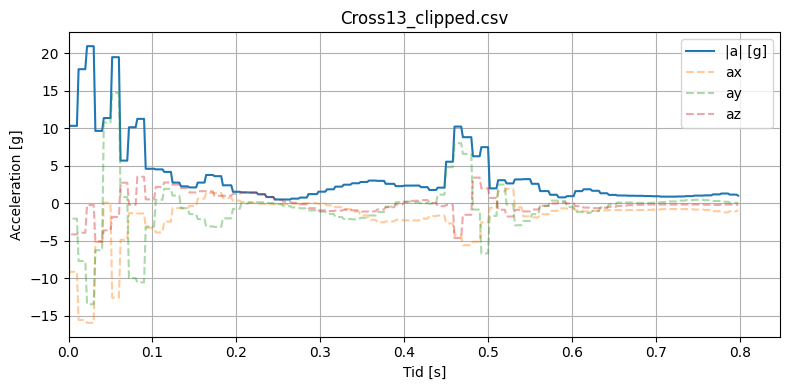

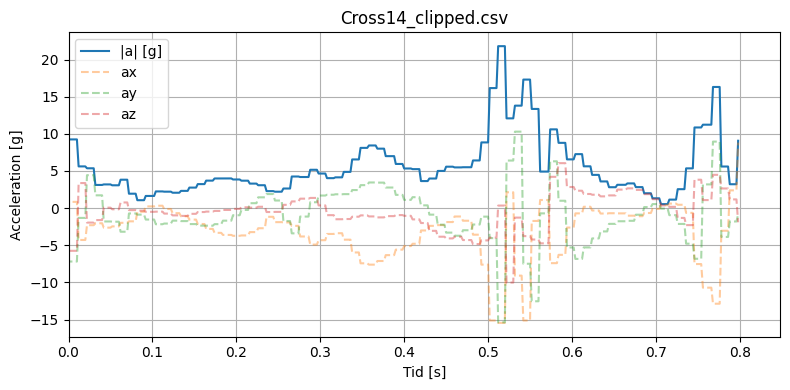

...

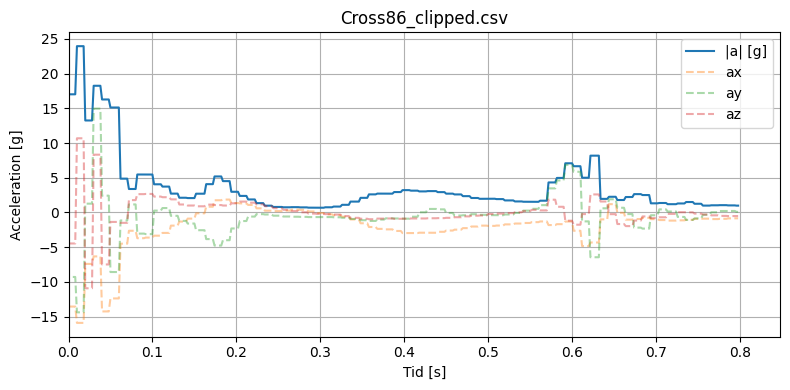

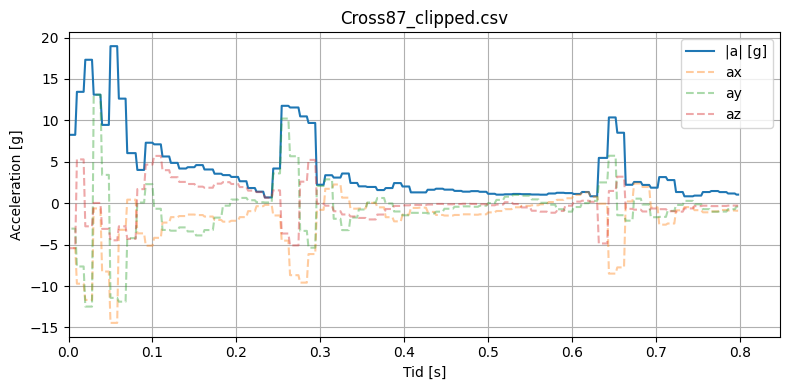

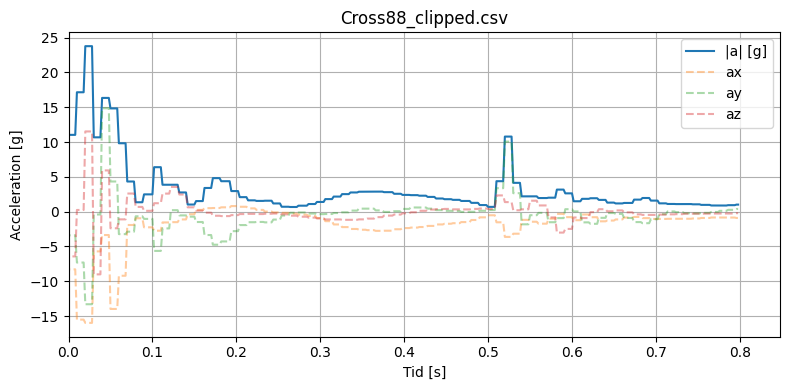

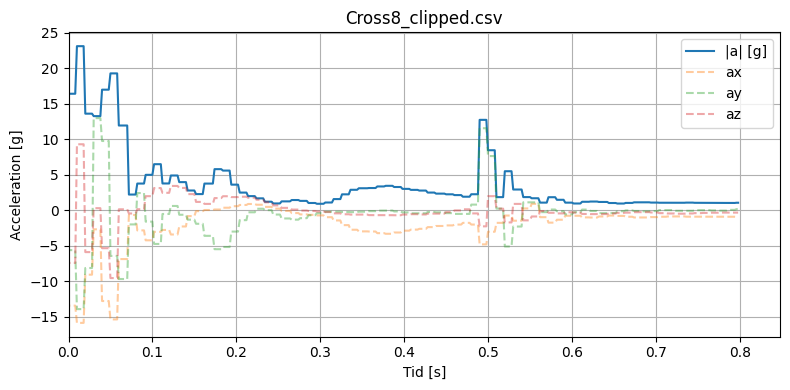

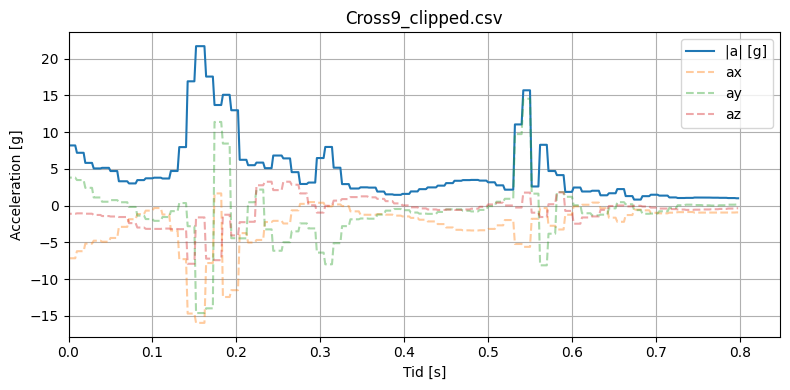

In [3]:
%matplotlib inline
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import glob, os

# Sti til dine klippede filer
path = r"c:\TML_Particle_EH5\Project\Project\DataValidation\Clipped_crosses"
files = sorted(glob.glob(os.path.join(path, "cross*_clipped.csv")))

for f in files:
    data = pd.read_csv(f)
    data.columns = [c.strip().lower() for c in data.columns]

    # Konverter til numeriske værdier
    for col in ['ax', 'ay', 'az', 'time', 'a_total']:
        data[col] = pd.to_numeric(data[col], errors='coerce')
    data.dropna(subset=['time', 'a_total'], inplace=True)

    # Tid er allerede i sekunder
    t = data['time'].values
    a_mag = data['a_total'].values

    # Plot
    plt.figure(figsize=(8, 4))
    plt.plot(t, a_mag, label='|a| [g]')
    plt.plot(t, data['ax'], '--', alpha=0.4, label='ax')
    plt.plot(t, data['ay'], '--', alpha=0.4, label='ay')
    plt.plot(t, data['az'], '--', alpha=0.4, label='az')
    plt.title(os.path.basename(f))
    plt.xlabel("Tid [s]")
    plt.ylabel("Acceleration [g]")
    plt.legend()
    plt.grid(True)
    plt.xlim(left=0)
    plt.tight_layout()
    plt.show()

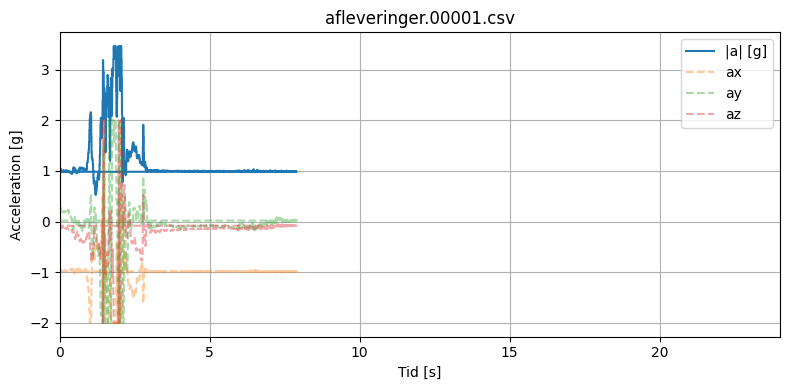

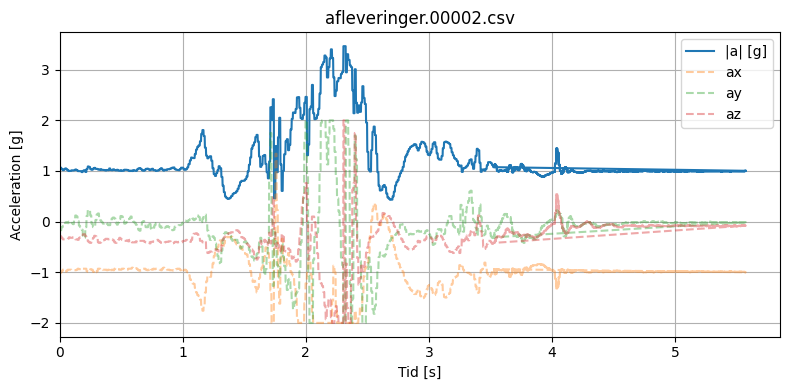

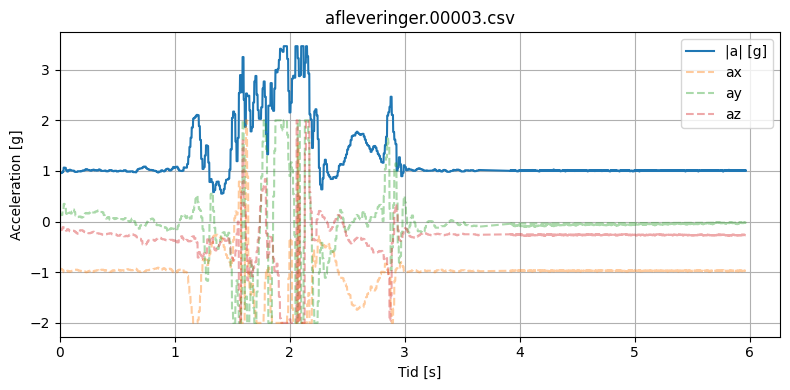

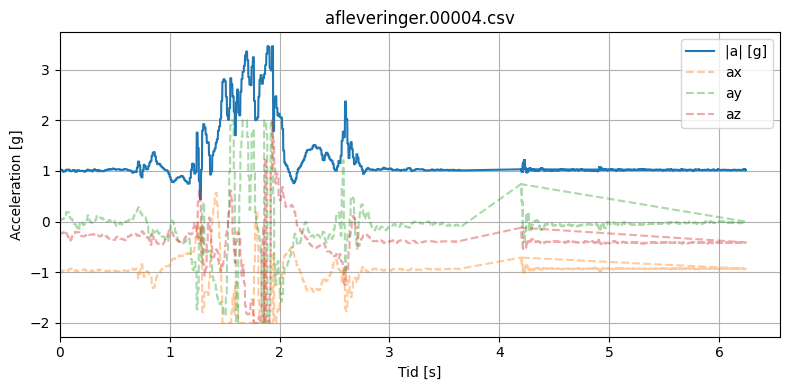

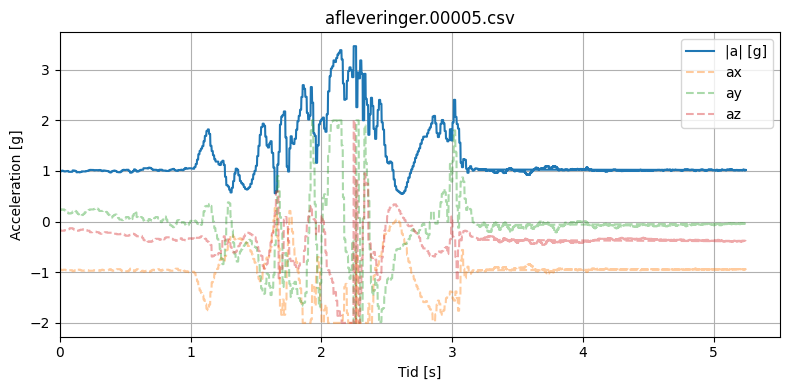

...

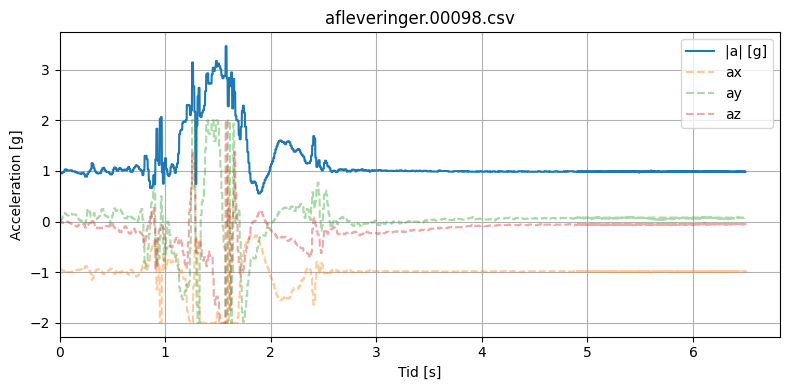

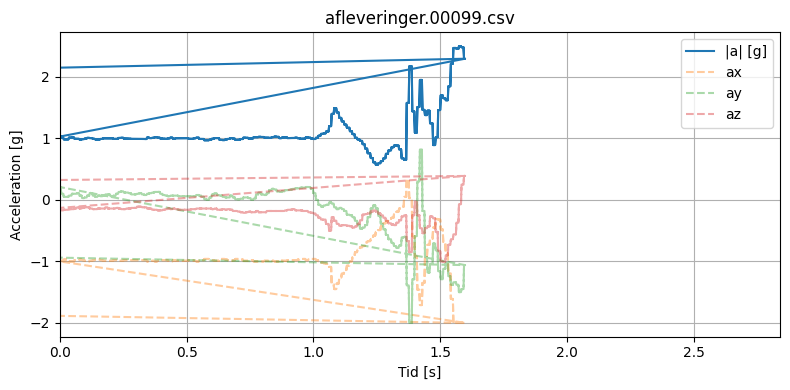

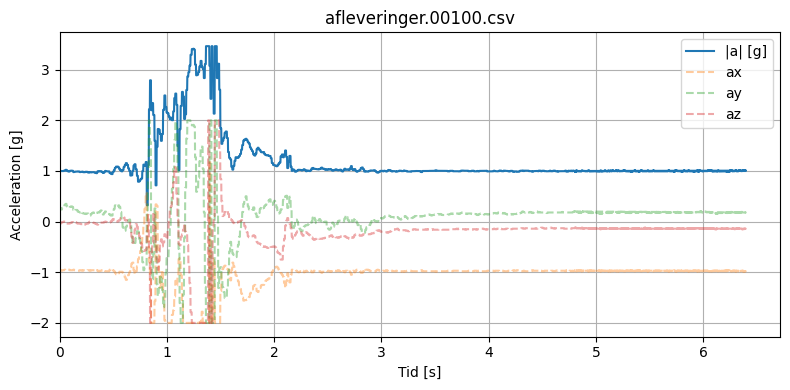

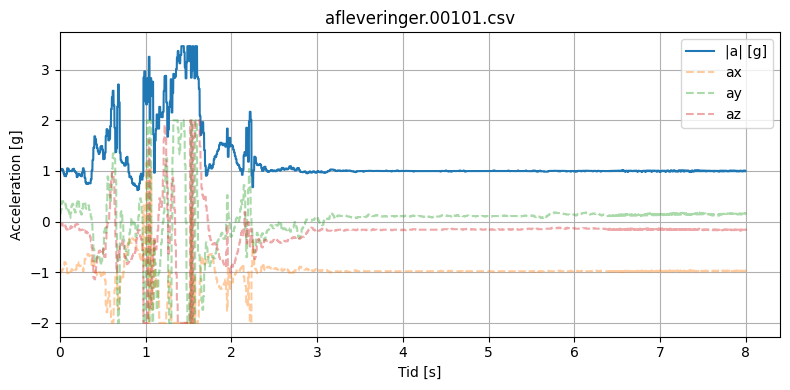

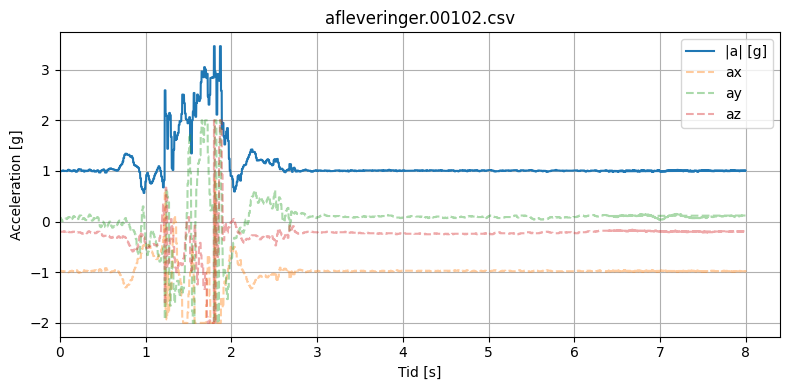

In [1]:
%matplotlib inline
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import glob, os

# Sti til dine Passes-målinger
path = r"c:\TML_Particle_EH5\Project\Project\DataValidation\Passes"
files = sorted(glob.glob(os.path.join(path, "afleveringer*.csv")))

for f in files:
    # Læs CSV med komma som separator
    data = pd.read_csv(f, sep=',', encoding='utf-8-sig')

    # Fjern mellemrum og skjulte tegn fra kolonnenavne
    data.columns = [c.strip().replace('\ufeff', '').lower() for c in data.columns]

    # Konverter kolonner til numeriske værdier
    for col in ['accx', 'accy', 'accz', 'timestamp']:
        data[col] = pd.to_numeric(data[col], errors='coerce')

    # Fjern rækker med manglende data
    data.dropna(subset=['accx', 'accy', 'accz', 'timestamp'], inplace=True)

    # Beregn samlet acceleration (norm)
    data['a_mag'] = np.sqrt(data['accx']**2 + data['accy']**2 + data['accz']**2)

    # Tid i sekunder (fra mikrosekunder)
    t = (data['timestamp'] - data['timestamp'].iloc[0]) * 1e-6

    # Plot
    plt.figure(figsize=(8, 4))
    plt.plot(t, data['a_mag'], label='|a| [g]')
    plt.plot(t, data['accx'], '--', alpha=0.4, label='ax')
    plt.plot(t, data['accy'], '--', alpha=0.4, label='ay')
    plt.plot(t, data['accz'], '--', alpha=0.4, label='az')
    plt.title(os.path.basename(f))
    plt.xlabel("Tid [s]")
    plt.ylabel("Acceleration [g]")
    plt.legend()
    plt.grid(True)
    plt.xlim(left=0)
    plt.tight_layout()
    plt.show()

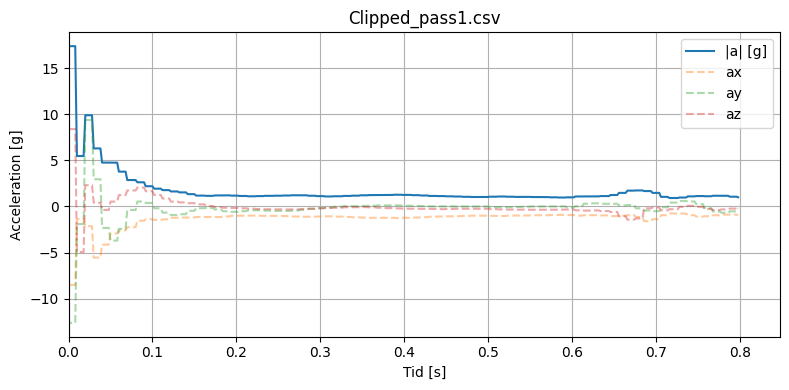

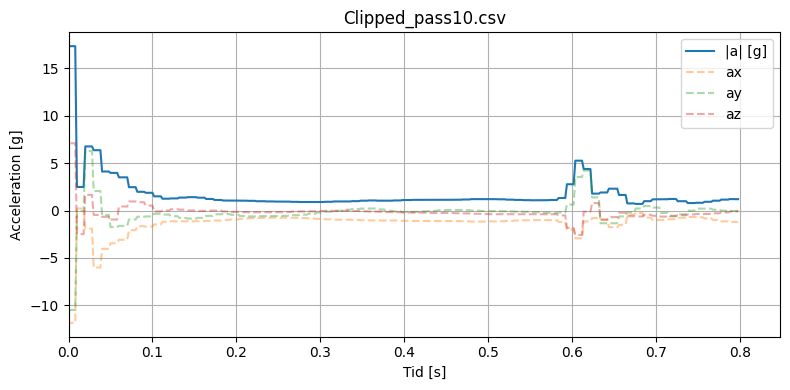

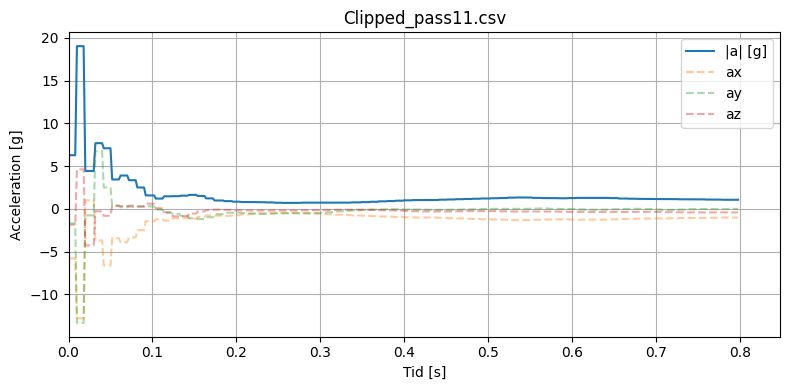

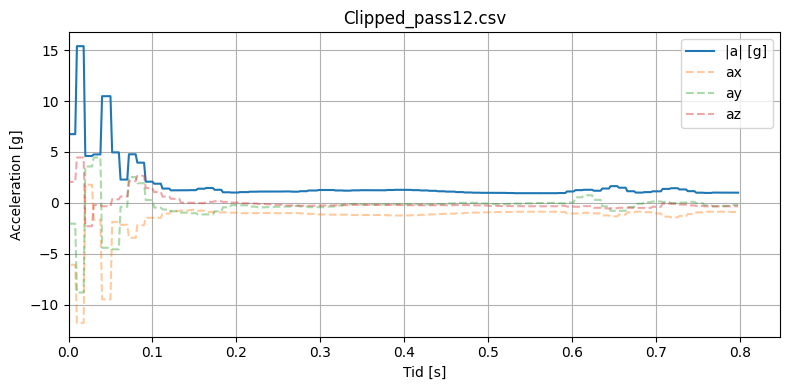

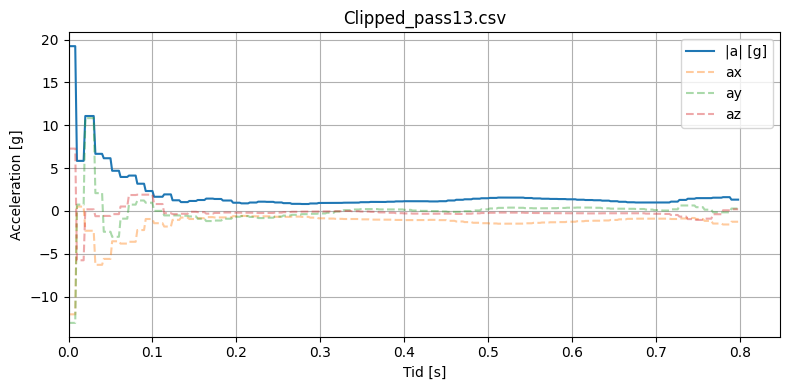

...

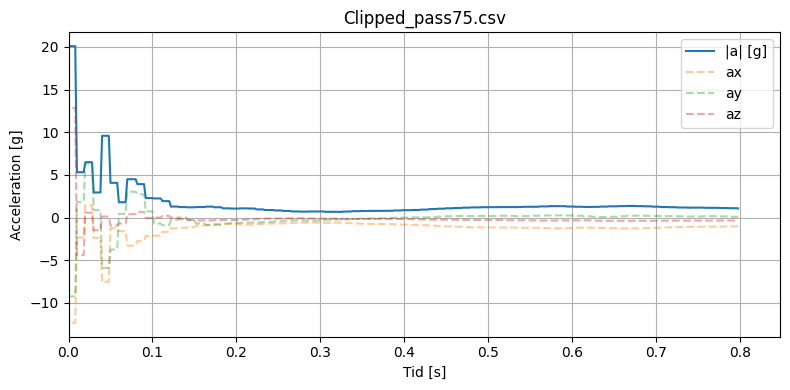

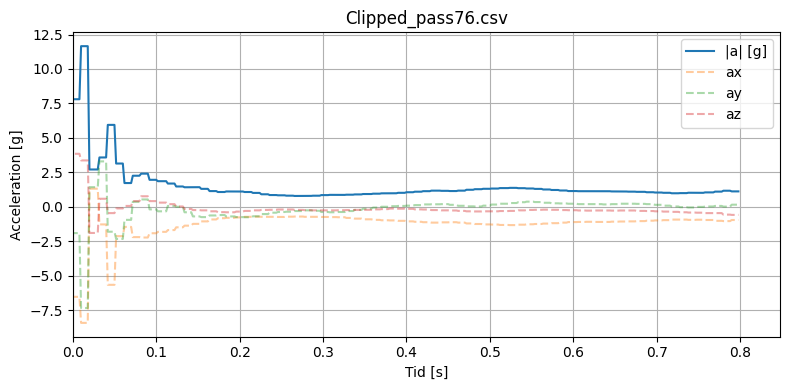

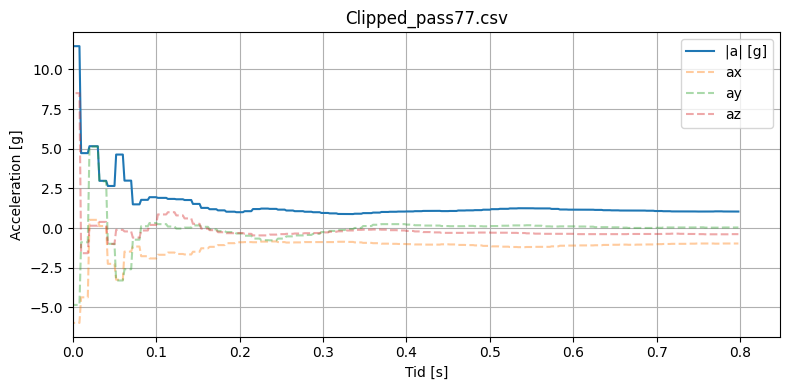

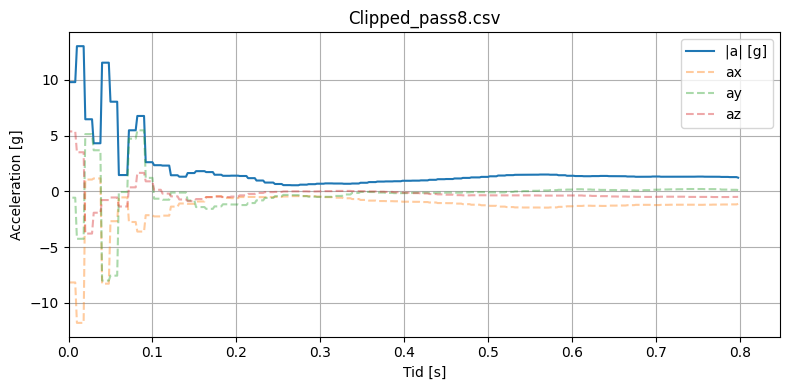

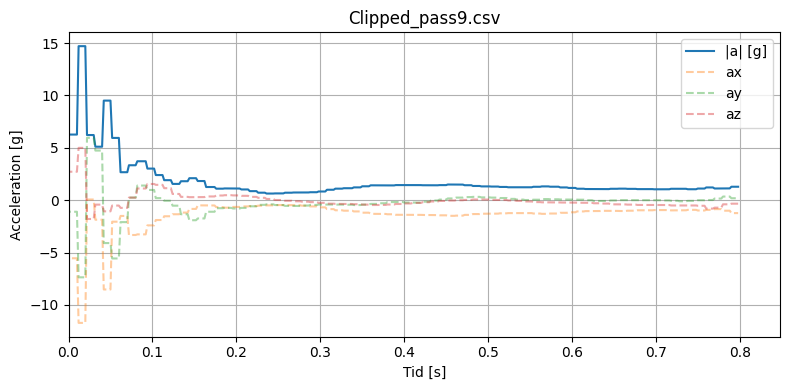

In [1]:
%matplotlib inline
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import glob, os

# Sti til dine klippede filer
path = r"c:\TML_Particle_EH5\Project\Project\DataValidation\Clipped_passes"
files = sorted(glob.glob(os.path.join(path, "Clipped_pass*.csv")))

for f in files:
    data = pd.read_csv(f)
    data.columns = [c.strip().lower() for c in data.columns]

    # Konverter til numeriske værdier
    for col in ['ax', 'ay', 'az', 'time', 'a_total']:
        data[col] = pd.to_numeric(data[col], errors='coerce')
    data.dropna(subset=['time', 'a_total'], inplace=True)

    # Tid er allerede i sekunder
    t = data['time'].values
    a_mag = data['a_total'].values

    # Plot
    plt.figure(figsize=(8, 4))
    plt.plot(t, a_mag, label='|a| [g]')
    plt.plot(t, data['ax'], '--', alpha=0.4, label='ax')
    plt.plot(t, data['ay'], '--', alpha=0.4, label='ay')
    plt.plot(t, data['az'], '--', alpha=0.4, label='az')
    plt.title(os.path.basename(f))
    plt.xlabel("Tid [s]")
    plt.ylabel("Acceleration [g]")
    plt.legend()
    plt.grid(True)
    plt.xlim(left=0)
    plt.tight_layout()
    plt.show()